Using the latest cached version of the dataset since openpecha/cleaned_MT_v1.0.2 couldn't be found on the Hugging Face Hub
Found the latest cached dataset configuration 'default' at /home/j/.cache/huggingface/datasets/openpecha___cleaned_mt_v1.0.2/default/0.0.0/f89a8ce696a5711c5dfd57352677aad125224ee9 (last modified on Sat Oct 26 18:17:08 2024).
INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: all-MiniLM-L6-v2
INFO:root:embedding texts...


Batches:   0%|          | 0/1563 [00:00<?, ?it/s]

INFO:root:building faiss index...
INFO:root:projecting with umap...
INFO:root:clustering...


Using HDBSCAN (num_samples)=(100)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

Request:
<s>[INST]Example 1:
Further, when an action being done is one of “no apparent agentother”, for example in ཛ་མཁན་གྱི་འཁོར་ལོ་འཁོར་རོ། “the potter’s wheel turning”, initially there is སྐོར་བྱེད་གཞན་ a turner and an other from it but once the wheel འཁོར་བཞིན་པའི་ is turning, that is, when it is just turning of itself without turner who is other, given that the situation has a non-separate action and agent, it is not expressed with “བསྐོར་”

Example 2:
བྲག་དམར་བྱ་ཁྱུང་ཚལ་གྱི་ཀེའུ་ཚང་དུ༔ drak mar jakhyung tsal gyi ké'u tsang du In the red rock cave Garuḍa Grove, སློབ་དཔོན་པྲ་བྷཱ་ཧསྟིའི་སྤྱན་སྔར་བྱོན༔ lobpön prabhahasti chen ngar jön You met the master Prabhāhasti, རྣལ་འབྱོར་ཡོ་གའི་ཆོས་ལ་སྦྱངས་པ་མཛད༔ naljor yogé chö la jangpa dzé And trained in the teachings of Yoga Tantra, ཡོ་གའི་ལྷ་ཚོགས་རྣམས་ཀྱི་ཞལ་གཟིགས་པའི༔ yogé lhatsok nam kyi zhalzikpé Till the whole assembly o

Example 3:
་་་་་་ གནས་ནི་རྒྱུད་དང་བསྟུན།།  But that doesn't really mean very much, first, second and third lineages 

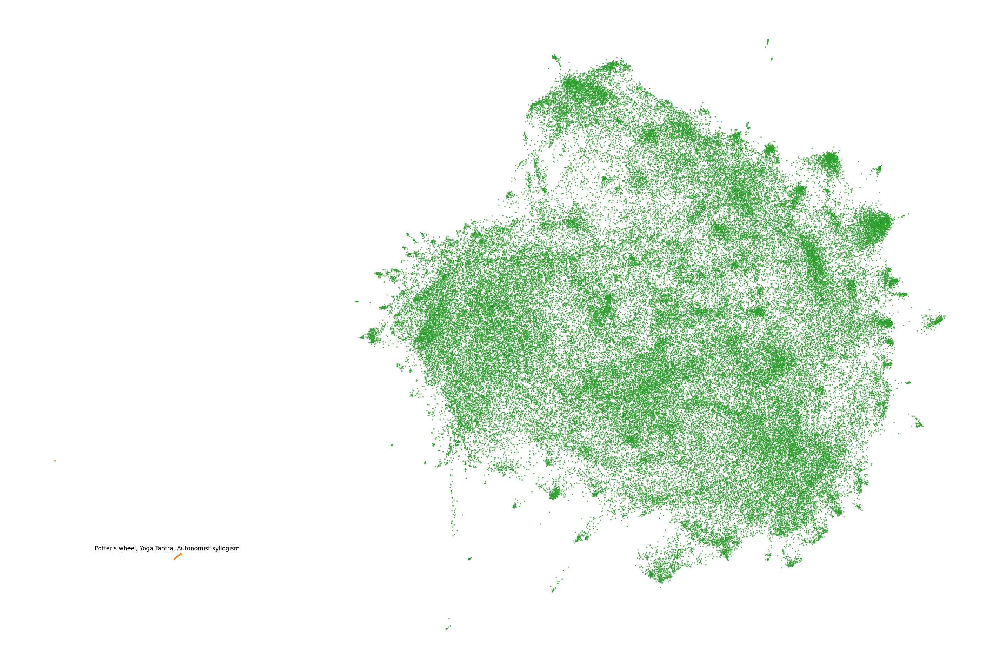

In [1]:
from src.text_clustering import ClusterClassifier
from datasets import load_dataset
import os
os.environ['CURL_CA_BUNDLE'] = ''

SAMPLE = 100_000

texts = load_dataset('openpecha/cleaned_MT_v1.0.2', split="train").select(range(SAMPLE))["Target"]

cc = ClusterClassifier(clustering_algorithm='hdbscan')

cc.fit(texts, min_samples=50)

cc.save(f'cc_100k_hdbscan_min_50')

cc.show()

INFO:root:using precomputed embeddings...
INFO:root:building faiss index...
INFO:root:using precomputed projections...
INFO:root:clustering...


Using DBSCAN (eps, num_samples)=((0.2,), 150)


INFO:root:summarizing cluster centers...


Request:
<s>[INST]Example 1:
Think that they are all like you in not desiring misery at all: “Alas! All my beloved sentient beings are in such pain.

Example 2:
To the amazement of the other students, Schwartz’s movement was picked up by the amplifier.

Example 3:
Although the illusory maiden conjured by a magician does not have true existence, she confuses the mind.

Example 4:
They were talking to me, years after their burials, and proving it by providing specific, very secret information.

Example 5:
It destroys all the thickets of unwholesome views. Seeing all products as being like dreams makes one's mindstream stainless. All this must be understood through meditative equipoise, and thus the Sakyas' teaching is subtle. Since the practices of Nirgranthas consist of a lack of hygiene and physical pain caused by the sun and wind, they can be understood by merely seeing them, and since Brahmins take recitation alon

Example 6:
Oh, yes indeed, yes indeed!

Example 7:
It happens too oft

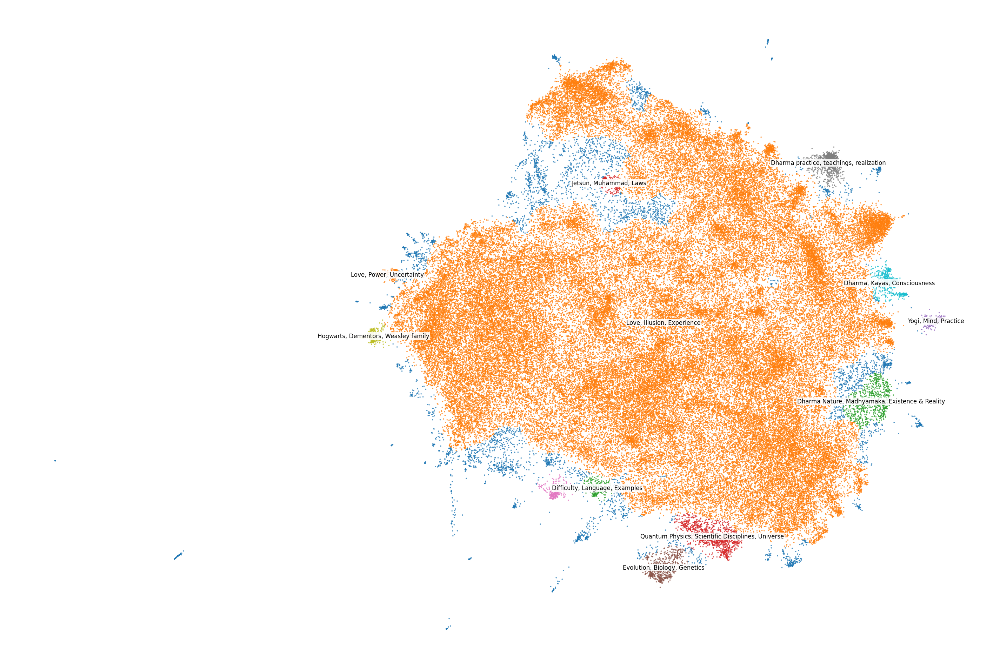

In [3]:
cc.fit(texts, min_samples=150, clustering_algorithm='dbscan', dbscan_eps=.2)

cc.show('cc_100k_dbscan_min_150')

In [29]:
cc.show(interactive=True)

In [4]:
cc.save('cc_100k_dbscan_min_150_eps_.2')

In [31]:
cc.cluster_summaries

{-1: 'None',
 0: 'Love, Illusion, Experience',
 1: 'Dharma Nature, Madhyamaka, Existence & Reality',
 2: 'Quantum Physics, Scientific Disciplines, Universe',
 3: 'Yogi, Mind, Practice',
 4: 'Evolution, Biology, Genetics',
 5: 'Business',
 6: 'Dharma practice, teachings, realization',
 7: 'Hogwarts, Dementors, Weasley family',
 8: 'Dharma, Kayas, Consciousness',
 9: 'Love, Power, Uncertainty',
 10: 'Difficulty, Language, Examples',
 11: 'Jetsun, Muhammad, Laws'}

In [26]:
def extract_label(cc, label):
    res_idx = cc.label2docs[label]
    res = [cc.texts[i] for i in res_idx]
    return res

In [28]:
harry_potter = extract_label(cc, 7)
harry_potter[0]

'Hermione, gasping for breath, her lip bleeding, scrambled aside, snatching up her and Ron’s wands.'

In [22]:
bio = cc.label2docs[4]
bio = [cc.texts[i] for i in bio]
bio[0]

'A very important family of proteins are the enzymes, which are the catalysts of life.'

In [24]:
phys = cc.label2docs[2]
phys = [cc.texts[i] for i in phys]
phys[0]

'Another advance was the discovery, which Rutherford had made by 1910, that the nucleus accounts for 99.9 percent of the mass of the atom but takes up only a tiny part of its volume.'